In [1]:
%env HSA_OVERRIDE_GFX_VERSION=11.0.0

env: HSA_OVERRIDE_GFX_VERSION=11.0.0


In [2]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import matplotlib.animation as animation
import torch
from matplotlib import animation



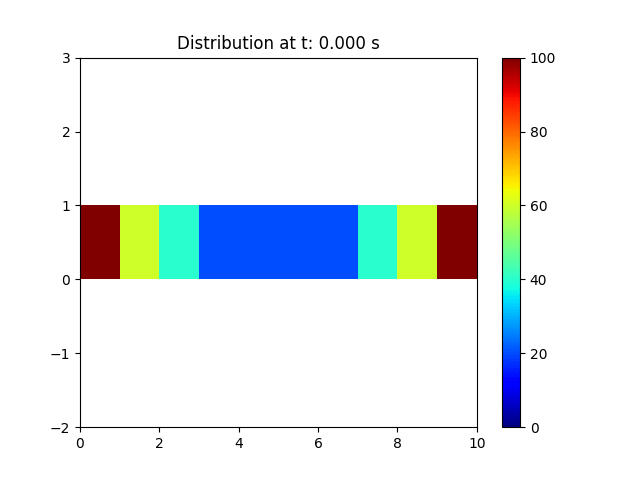

t: 0.000 [s], Average temp: 44.00 C
t: 0.000 [s], Average temp: 48.00 C
t: 0.114 [s], Average temp: 52.00 C
t: 0.227 [s], Average temp: 55.00 C
t: 0.341 [s], Average temp: 58.00 C
t: 0.455 [s], Average temp: 60.50 C
t: 0.568 [s], Average temp: 63.00 C
t: 0.682 [s], Average temp: 65.19 C
t: 0.795 [s], Average temp: 67.34 C
t: 0.909 [s], Average temp: 69.28 C
t: 1.023 [s], Average temp: 71.16 C
t: 1.136 [s], Average temp: 72.88 C
t: 1.250 [s], Average temp: 74.54 C
t: 1.364 [s], Average temp: 76.06 C
t: 1.477 [s], Average temp: 77.51 C
t: 1.591 [s], Average temp: 78.86 C
t: 1.705 [s], Average temp: 80.14 C
t: 1.818 [s], Average temp: 81.33 C
t: 1.932 [s], Average temp: 82.46 C
t: 2.045 [s], Average temp: 83.52 C
t: 2.159 [s], Average temp: 84.51 C
t: 2.273 [s], Average temp: 85.45 C
t: 2.386 [s], Average temp: 86.33 C
t: 2.500 [s], Average temp: 87.15 C
t: 2.614 [s], Average temp: 87.93 C
t: 2.727 [s], Average temp: 88.65 C
t: 2.841 [s], Average temp: 89.34 C
t: 2.955 [s], Average temp: 

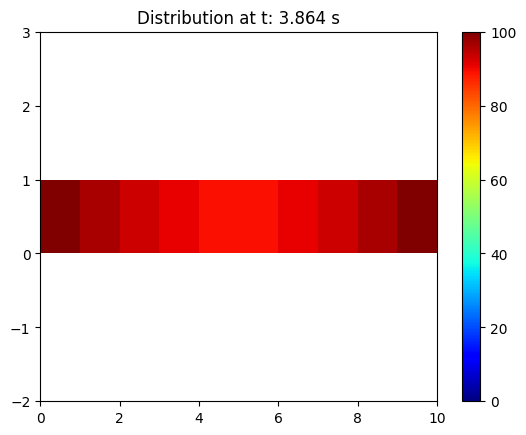

In [3]:
# Parameters
a = 110  # thermal diffusivity
length = 50  # length of the rod
time = 4  # total simulation time
nodes = 10  # number of nodes

# Initialize grid and other variables
dx = length / nodes
dt = 0.5 * dx ** 2 / a
t_nodes = int(time / dt)

# Boundary conditions
u = np.zeros(nodes) + 20
u[0] = 100
u[-1] = 100

# Set up the plot
fig, axis = plt.subplots()
pcm = axis.pcolormesh([u], cmap=plt.cm.jet, vmin=0, vmax=100)
plt.colorbar(pcm, ax=axis)
axis.set_ylim([-2, 3])
axis.set_title("Distribution at t = 0.0 s")

# Update function for animation
def update(frame):
    global u  # Use global u to update the solution
    w = u.copy()
    
    # Simulation step
    for i in range(1, nodes - 1):
        u[i] = dt * a * (w[i-1] - 2*w[i] + w[i+1]) / dx**2 + w[i]
    
    # Update plot
    pcm.set_array([u])
    axis.set_title("Distribution at t: {:.3f} s".format(frame * dt))
    print("t: {:.3f} [s], Average temp: {:.2f} C".format(frame * dt, np.average(u)))

    return pcm,  # Return the updated plot object for FuncAnimation

# Create the animation
ani = FuncAnimation(fig, update, frames=t_nodes, interval=100, repeat=False)

# Save the animation as .webm (requires ffmpeg)
ani.save('heat_equation_animation.gif', writer='ffmpeg', fps=30)

# Display the plot
plt.show()

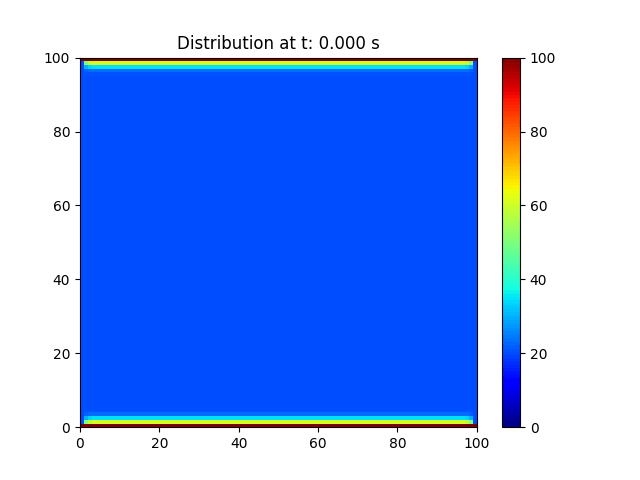

KeyboardInterrupt: 

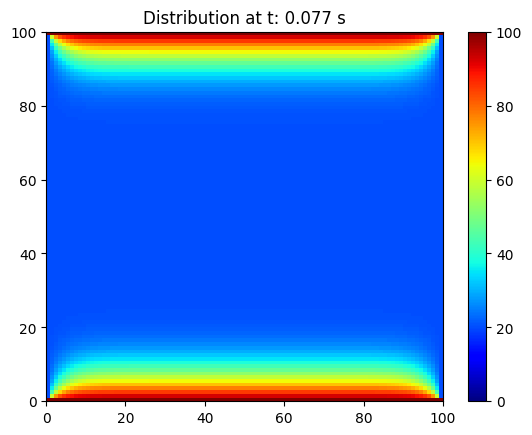

In [4]:
# Parameters
a = 110
length_x = 50
length_y = 50
time = 1
nodes = 100

# Initialize
dx = length_x / nodes
dy = length_y / nodes
dt = min(dx ** 2 / (4 * a), dy ** 2 / (4 * a))
t_nodes = int(time / dt)

u = np.zeros((nodes, nodes)) + 20  # Initial temperature: 20°C
u[0, :] = 100  # Top boundary
u[-1, :] = 100  # Bottom boundary

# Plot setup
fig, axis = plt.subplots()
pcm = axis.pcolormesh(u, cmap=plt.cm.jet, vmin=0, vmax=100)
plt.colorbar(pcm, ax=axis)

# Update function
def update(frame):
    global u
    w = u.copy()
    for i in range(1, nodes - 1):
        for j in range(1, nodes - 1):
            dd_ux = (w[i - 1, j] - 2 * w[i, j] + w[i + 1, j]) / dx ** 2
            dd_uy = (w[i, j - 1] - 2 * w[i, j] + w[i, j + 1]) / dy ** 2
            u[i, j] = dt * a * (dd_ux + dd_uy) + w[i, j]

    pcm.set_array(u.ravel())
    axis.set_title(f"Distribution at t: {frame * dt:.3f} s")
    return pcm,

# Animate
ani = animation.FuncAnimation(fig, update, frames=t_nodes, interval=50, blit=True)

# Save animation
ani.save('heat_distribution_2d_animation.gif', writer='pillow', fps=30)
plt.show()

In [6]:
if torch.cuda.is_available():
    print("CUDA is available. Running on GPU.")
else:
    print("CUDA is not available. Running on CPU.")


CUDA is available. Running on GPU.


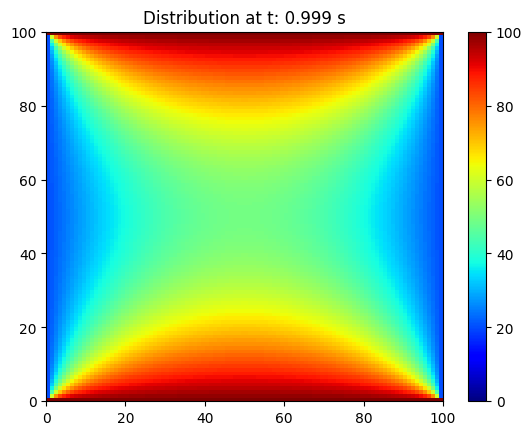

In [7]:
# Parameters
a = 110  # Thermal diffusivity
length_x = 50
length_y = 50
time = 1  # Total simulation time
nodes = 100  # Number of grid points

# Initialize
dx = length_x / nodes
dy = length_y / nodes
dt = min(dx**2 / (4 * a), dy**2 / (4 * a))
t_nodes = int(time / dt)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Temperature grid (2D) initialized to 20°C
u = torch.zeros((nodes, nodes), device=device) + 20
u[0, :] = 100  # Top boundary
u[-1, :] = 100  # Bottom boundary

# Plot setup
fig, axis = plt.subplots()
pcm = axis.pcolormesh(u.cpu(), cmap=plt.cm.jet, vmin=0, vmax=100)
plt.colorbar(pcm, ax=axis)

# Simulation function
def simulate_heat_diffusion(u, dt, dx, dy, a, t_nodes):
    for _ in range(t_nodes):
        u_new = u.clone()

        # Laplacian calculation (vectorized)
        u_new[1:-1, 1:-1] = u[1:-1, 1:-1] + a * dt * (
            (u[:-2, 1:-1] - 2 * u[1:-1, 1:-1] + u[2:, 1:-1]) / dx**2 +
            (u[1:-1, :-2] - 2 * u[1:-1, 1:-1] + u[1:-1, 2:]) / dy**2
        )

        # Update the grid
        u = u_new

        # Maintain boundary conditions
        u[0, :] = 100
        u[-1, :] = 100

    return u

# Update function for animation
def update(frame):
    global u
    u_new = u.clone()

    # Apply the heat diffusion calculation
    u_new[1:-1, 1:-1] += a * dt * (
        (u[:-2, 1:-1] - 2 * u[1:-1, 1:-1] + u[2:, 1:-1]) / dx**2 +
        (u[1:-1, :-2] - 2 * u[1:-1, 1:-1] + u[1:-1, 2:]) / dy**2
    )
    
    u = u_new

    # Maintain boundary conditions
    u[0, :] = 100
    u[-1, :] = 100

    # Only transfer to CPU for visualization at this step
    pcm.set_array(u.cpu().numpy().ravel())
    axis.set_title(f"Distribution at t: {frame * dt:.3f} s")
    return pcm,

# Run simulation for plotting
u = simulate_heat_diffusion(u, dt, dx, dy, a, t_nodes)

# Animation
ani = animation.FuncAnimation(fig, update, frames=t_nodes, interval=50, blit=True)

# Save animation
ani.save("heat_distribution_2d_pytorch.gif", writer="pillow", fps=30)
plt.show()
